In [61]:
import os
import glob
import pandas as pd
import numpy as np
from scipy.signal import resample as sci_resample
from sklearn.preprocessing import StandardScaler
import librosa
from mtrf import TRF
from mtrf.stats import nested_crossval
import mediapipe as mp
from mediapipe.tasks import python
from mediapipe.tasks.python import vision
import cv2
from ast import literal_eval
import pickle
import matplotlib.pyplot as plt
import seaborn as sns

# Load DataFrame of trials

In [2]:
lst_df = []
for dir in (glob.glob(f'./data/responses/*')):
    if len(os.listdir(dir)) != 0:
        files = glob.glob(dir+'/*.csv')
        for i in range(len(files)):
            if len(files) == 4:
                if i != 0:
                    temp_df = pd.read_csv(files[i])
                    lst_df.append(temp_df)
            else:
                temp_df = pd.read_csv(files[i])
                lst_df.append(temp_df)
                
df = pd.concat(lst_df)
df = df[df.Block == 'va']

df['Condition'] = df['Condition'].apply(lambda x: 'true' if x=='TRUE' else 'fake')
df['DisplayedDyad'] = df['AudioPath'].str.split('/').str[4]
df['VideoPath'] = df['VideoPath'].str.replace('\\', '/')
df['Accuracy'] = (df.CorrectResp == df.Resp)
df = df.drop(['Date', 'Subject', 'Age', 'Sex', 'TrialNumber', 'BlockNumber', 'SpeakerID', 'ListenerID', 'LikertResp'], axis=1).reset_index(drop=True)

In [3]:
def get_listener_video(data):
    listener_sex = 'M' if data.SpeakerSex == 'F' else 'F'
    path = f'./stim/raw_extracts/{data.ListenerDyad}/{data.ListenerDyad}_{data.ListenerExtract}_{listener_sex}.mov'

    return path


df['VideoPath'] = df.apply(lambda x: get_listener_video(x), axis=1)
df

,Block,VideoPath,AudioPath,SpeakerDyad,ListenerDyad,SpeakerExtract,ListenerExtract,Condition,SpeakerSex,Duration,CorrectResp,Resp,DisplayedDyad,Accuracy
0,va,./stim/raw_extracts/31/31_8_F.mov,./stim/processed_extracts/audio/31/8_audio.wav,31,31,8,8,true,M,10,g,g,31,True
1,va,./stim/raw_extracts/7/7_2_F.mov,./stim/processed_extracts/audio/7/1_2_audio.wav,7,7,1,2,fake,M,8,h,h,7,True
2,va,./stim/raw_extracts/5/5_1_M.mov,./stim/processed_extracts/audio/5/1_audio.wav,5,5,1,1,true,F,19,g,g,5,True
3,va,./stim/raw_extracts/54/54_5_M.mov,./stim/processed_extracts/audio/54/5_audio.wav,54,54,5,5,true,F,8,g,h,54,False
4,va,./stim/raw_extracts/35/35_4_M.mov,./stim/processed_extracts/audio/43/35_4_40_3_a...,40,35,3,4,fake,F,13,h,h,43,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1183,va,./stim/raw_extracts/44/44_3_F.mov,./stim/processed_extracts/audio/44/3_audio.wav,44,44,3,3,true,M,8,g,g,44,True
1184,va,./stim/raw_extracts/9/9_3_M.mov,./stim/processed_extracts/audio/9/1_3_audio.wav,9,9,1,3,fake,F,7,g,h,9,False
1185,va,./stim/raw_extracts/37/37_1_M.mov,./stim/processed_extracts/audio/37/1_audio.wav,37,37,1,1,true,F,6,g,h,37,False
1186,va,./stim/raw_extracts/10/10_1_F.mov,./stim/processed_extracts/audio/4/10_1_11_3_au...,11,10,3,1,fake,M,11,g,h,4,False


# Get face landmarks

In [4]:
def get_landmarks(file):
    base_options = python.BaseOptions(model_asset_path='face_landmarker.task')
    options = vision.FaceLandmarkerOptions(
        base_options=base_options,
        output_facial_transformation_matrixes=True,
        running_mode=vision.RunningMode.VIDEO
    )

    frames = []
    with vision.FaceLandmarker.create_from_options(options) as landmarker:
        video = cv2.VideoCapture(file)
        try:
            while True:
                ret, frame = video.read()
                if not ret:
                    video.release()
                    break
                fps = video.get(cv2.CAP_PROP_FPS)
                timestamp = video.get(cv2.CAP_PROP_POS_MSEC)
                mp_image = mp.Image(image_format=mp.ImageFormat.SRGB, data=frame)
                face_landmarker_result = landmarker.detect_for_video(mp_image, int(timestamp))
                frames.append(face_landmarker_result)
        except KeyboardInterrupt:
            pass
        finally:
            video.release()

    return frames

In [5]:
# for idx, row in df.drop_duplicates('VideoPath').iterrows():
#     frames = get_landmarks(row.VideoPath)

#     frame_lms = []
#     for frame in frames:
#         if len(frame.face_landmarks) != 0:
#             landmarks = frame.face_landmarks[0]
#             lms = []
#             for landmark in landmarks:
#                 lms.append((landmark.x, landmark.y, landmark.z))
#             frame_lms.append(lms)
#         else:
#             print(row.VideoPath)
    
#         pd.DataFrame(frame_lms).to_csv(f"./landmark_files/{row.ListenerDyad}_{row.ListenerExtract}_{'M' if row.SpeakerSex == 'F' else 'F'}.csv")


# Videos where face couldn't be tracked
# 1/1_4_M.mov
# 8/8_5_M.mov
# 8/8_6_M.mov
# 44/44_3_F.mov

# Train TRF

In [6]:
store = {
    'sr': 30,
    'condition': 'true',
    'modality': 'va',
    'input_type': 'auditory_nerve',
    'output_type': 'landmarks',
    'trf_min_lag': 0,
    'trf_max_lag': 3,
    'num_landmarks': 478
}

In [7]:
def resample_signal(data_type, signal, length):
    signal_resampled = sci_resample(signal, len(np.arange(0, length, 1/store.get('sr'))))

    standardize = StandardScaler()
    if data_type == 'rms' or data_type == 'auditory_nerve':
        signal_resampled = standardize.fit_transform(signal_resampled.reshape(-1, 1))
        return signal_resampled.flatten()
    else:
        signal_resampled = standardize.fit_transform(signal_resampled)
        return signal_resampled


def get_data(data_type, file, length, landmark=None):
    match data_type:
        case 'rms':
            audio, audio_sr = librosa.load(file)
            rms_win = 0.5
            rms_hop = 1/store.get('sr') 
            rms = librosa.feature.rms(y=audio, frame_length=int(store.get('sr')*rms_win), hop_length=int(store.get('sr')*rms_hop))
            data=rms[0]
        case 'auditory_nerve':
            file = file.replace(os.sep, '/')
            df = pd.read_csv(file, usecols=[1])
            data = df.to_numpy().flatten()
        case 'landmarks':
            temp = pd.read_csv(file, usecols=[landmark], converters={landmark: literal_eval})[landmark].to_numpy()
            data = []
            for d in temp:
                data.append(np.array(d))
            data = np.asarray(data)
        case _:
            raise ValueError(f"{data_type} not a valid value for data_type. Valid values are: ['rms', 'auditory_nerve', 'landmark']")

    data = resample_signal(data_type, data, length)
        
    return data


def trial_info(trial):
    video_path = trial['VideoPath']
    audio_path = trial['AudioPath']
    disp_dyad = trial['DisplayedDyad']
    listener_dyad = trial['ListenerDyad']
    duration = trial['Duration']
    condition = trial['Condition']
    an_path = audio_path.replace('_audio.wav', '.csv').replace('audio', 'audio_carney')
    landmark_path = video_path.replace(f'./stim/raw_extracts/{listener_dyad}', './landmark_files').replace('mov', 'csv')

    return {'VideoPath': video_path, 'AudioPath': audio_path, 'DisplayedDyad': disp_dyad, 
            'Duration': duration, 'Condition': condition, 'ANPath': an_path, 'LandmarkPath': landmark_path}


def prepare_input(data, condition, landmark=None):
    stims = []
    resps = []
        
    for idx, row in data[data['Condition']==store.get('condition')].iterrows():
        info = trial_info(row)
        if os.path.exists(info['LandmarkPath']):
            stim = get_data(data_type=store.get('input_type'), file=info['ANPath'], length=info['Duration'])
            stims.append(stim)

            resp = get_data(data_type=store.get('output_type'), file=info['LandmarkPath'], length=info['Duration'], landmark=landmark)
            resps.append(resp)

    return stims, resps

In [8]:
trfs = []
regularization = np.logspace(-1, 6, 10)

for i in range(store.get('num_landmarks')):
    stims, resps = prepare_input(data=df.drop_duplicates('VideoPath'), condition='true', landmark=str(i))
    trf = TRF(direction=1)
    r_unbiased, best_regularization = nested_crossval(
        model=trf, 
        stimulus=stims, 
        response=resps, 
        fs=store.get('sr'), 
        tmin=store.get('trf_min_lag'), 
        tmax=store.get('trf_max_lag'), 
        regularization=regularization, 
        k=5, 
        verbose=False,
        seed=1
    )
    trf.train(
                stimulus=stims, 
                response=resps, 
                fs=store.get('sr'), 
                tmin=store.get('trf_min_lag'), 
                tmax=store.get('trf_max_lag'), 
                regularization=best_regularization,
                seed=1
    )
    trfs.append(trf)

Cross-validating[##################################################] 84/84....] 0/5

Cross-validating[##################################################] 84/84....] 1/5

Cross-validating[##################################################] 84/84....] 2/5

Cross-validating[##################################################] 84/84....] 3/5

Cross-validating[##################################################] 84/84....] 4/5

Hyperparameter optimization[##################################################] 5/5

Cross-validating[##################################################] 84/84....] 0/5

Cross-validating[##################################################] 84/84....] 1/5

Cross-validating[##################################################] 84/84....] 2/5

Cross-validating[##################################################] 84/84....] 3/5

Cross-validating[##################################################] 84/84....] 4/5

Hyperparameter optimization[#####################################

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



Cross-validating[##################################################] 84/84....] 0/5

Cross-validating[##################################################] 84/84....] 1/5

Cross-validating[##################################################] 84/84....] 2/5

Cross-validating[##################################################] 84/84....] 3/5

Cross-validating[##################################################] 84/84....] 4/5

Hyperparameter optimization[##################################################] 5/5

Cross-validating[##################################################] 84/84....] 0/5

Cross-validating[##################################################] 84/84....] 1/5

Cross-validating[##################################################] 84/84....] 2/5

Cross-validating[##################################################] 84/84....] 3/5

Cross-validating[##################################################] 84/84....] 0/5

Cross-validating[################################################

In [10]:
# pickle TRFs
with open('trfs.pkl', 'wb') as f:
    pickle.dump(trfs, f)

In [ ]:
# load pickled TRFs
with open('trfs.pkl', 'rb') as f:
    trfs = pickle.load(f)

# Make predictions

In [19]:
def predict_response(data, trfs):
    landmarks = []
    predictions = []
    correlations = []

    for idx, row in data.iterrows():
        info = trial_info(row)
        print(idx)
        print('****************************************************')
        for i in range(store.get('num_landmarks')):
            if os.path.exists(info['LandmarkPath']):
                stim = get_data(data_type=store.get('input_type'), file=info['ANPath'], length=info['Duration'])
                resp = get_data(data_type=store.get('output_type'), file=info['LandmarkPath'], length=info['Duration'], landmark=str(i))

                prediction, correlation = trfs[i].predict(stimulus=stim, response=resp, average=True)

                landmarks.append(str(i))
                predictions.append(prediction)
                correlations.append(correlation)
            else:
                print(f"Missing file: {info['LandmarkPath']}. Skipping...")

    return landmarks, predictions, correlations

In [20]:
landmarks, predictions, correlations = predict_response(df.drop_duplicates('VideoPath'), trfs)

0
****************************************************
1
****************************************************
2
****************************************************
Missing file: ./landmark_files/5_1_M.csv. Skipping...
Missing file: ./landmark_files/5_1_M.csv. Skipping...
Missing file: ./landmark_files/5_1_M.csv. Skipping...
Missing file: ./landmark_files/5_1_M.csv. Skipping...
Missing file: ./landmark_files/5_1_M.csv. Skipping...
Missing file: ./landmark_files/5_1_M.csv. Skipping...
Missing file: ./landmark_files/5_1_M.csv. Skipping...
Missing file: ./landmark_files/5_1_M.csv. Skipping...
Missing file: ./landmark_files/5_1_M.csv. Skipping...
Missing file: ./landmark_files/5_1_M.csv. Skipping...
Missing file: ./landmark_files/5_1_M.csv. Skipping...
Missing file: ./landmark_files/5_1_M.csv. Skipping...
Missing file: ./landmark_files/5_1_M.csv. Skipping...
Missing file: ./landmark_files/5_1_M.csv. Skipping...
Missing file: ./landmark_files/5_1_M.csv. Skipping...
Missing file: ./landmark_

In [34]:
exclude = [
    '5_1_M.csv', '12_3_M.csv', '52_3_F.csv', 
    '36_3_M.csv', '2_1_F.csv', '43_4_F.csv', 
    '38_4_F.csv', '4_4_F.csv', '57_1_F.csv',
    '56_1_F.csv', '29_1_F.csv', '46_2_M.csv',
    '24_4_M.csv', '14_2_F.csv', '8_1_F.csv',
    '4_7_M.csv'
]

# Get actual - predicted for each trial

In [21]:
with open('landmarks.pkl', 'wb') as f1:
    pickle.dump(landmarks, f1)

with open('predictions.pkl', 'wb') as f2:
    pickle.dump(predictions, f2)

with open('correlations.pkl', 'wb') as f3:
    pickle.dump(correlations, f3)

In [27]:
landmarks_reshaped = np.reshape(landmarks, (184, store.get('num_landmarks')))

In [29]:
correlations_reshaped = np.reshape(correlations, (184, store.get('num_landmarks')))

In [ ]:
df_post = df.drop_duplicates('VideoPath')
df_post['VideoPathNew'] = df.apply(lambda x: x['VideoPath'].split('/')[-1].replace('mov', 'csv'), axis=1)

In [50]:
df_post = df_post[~df_post.VideoPathNew.isin(exclude)]

,Block,VideoPath,AudioPath,SpeakerDyad,ListenerDyad,SpeakerExtract,ListenerExtract,Condition,SpeakerSex,Duration,CorrectResp,Resp,DisplayedDyad,Accuracy,VideoPathNew
0,va,./stim/raw_extracts/31/31_8_F.mov,./stim/processed_extracts/audio/31/8_audio.wav,31,31,8,8,true,M,10,g,g,31,True,31_8_F.csv
1,va,./stim/raw_extracts/7/7_2_F.mov,./stim/processed_extracts/audio/7/1_2_audio.wav,7,7,1,2,fake,M,8,h,h,7,True,7_2_F.csv
3,va,./stim/raw_extracts/54/54_5_M.mov,./stim/processed_extracts/audio/54/5_audio.wav,54,54,5,5,true,F,8,g,h,54,False,54_5_M.csv
4,va,./stim/raw_extracts/35/35_4_M.mov,./stim/processed_extracts/audio/43/35_4_40_3_a...,40,35,3,4,fake,F,13,h,h,43,True,35_4_M.csv
5,va,./stim/raw_extracts/17/17_1_F.mov,./stim/processed_extracts/audio/18/17_1_20_2_a...,20,17,2,1,fake,M,9,h,h,18,True,17_1_F.csv
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
411,va,./stim/raw_extracts/8/8_5_M.mov,./stim/processed_extracts/audio/8/4_5_audio.wav,8,8,4,5,fake,F,9,g,g,8,True,8_5_M.csv
431,va,./stim/raw_extracts/47/47_7_F.mov,./stim/processed_extracts/audio/47/7_audio.wav,47,47,7,7,true,M,13,g,g,47,True,47_7_F.csv
452,va,./stim/raw_extracts/32/32_1_F.mov,./stim/processed_extracts/audio/32/1_audio.wav,32,32,1,1,true,M,14,g,g,32,True,32_1_F.csv
523,va,./stim/raw_extracts/51/51_1_F.mov,./stim/processed_extracts/audio/50/51_1_54_4_a...,54,51,4,1,fake,M,8,g,g,50,True,51_1_F.csv


In [52]:
df_post['Landmark'] = list(landmarks_reshaped)
df_post['Pearsonr'] = list(correlations_reshaped)

In [55]:
df_post = df_post.explode(column=['Landmark', 'Pearsonr'])
df_post['Prediction'] = predictions
df_post

,Block,VideoPath,AudioPath,SpeakerDyad,ListenerDyad,SpeakerExtract,ListenerExtract,Condition,SpeakerSex,Duration,CorrectResp,Resp,DisplayedDyad,Accuracy,VideoPathNew,Landmark,Pearsonr,Prediction
0,va,./stim/raw_extracts/31/31_8_F.mov,./stim/processed_extracts/audio/31/8_audio.wav,31,31,8,8,true,M,10,g,g,31,True,31_8_F.csv,0,-0.079595,"[[[4.0629557909296195e-07, -2.1182912310210647..."
0,va,./stim/raw_extracts/31/31_8_F.mov,./stim/processed_extracts/audio/31/8_audio.wav,31,31,8,8,true,M,10,g,g,31,True,31_8_F.csv,1,0.089893,"[[[0.01369549283776041, -0.005249466465435711,..."
0,va,./stim/raw_extracts/31/31_8_F.mov,./stim/processed_extracts/audio/31/8_audio.wav,31,31,8,8,true,M,10,g,g,31,True,31_8_F.csv,2,0.031218,"[[[4.173200711169096e-07, -2.3710549091323515e..."
0,va,./stim/raw_extracts/31/31_8_F.mov,./stim/processed_extracts/audio/31/8_audio.wav,31,31,8,8,true,M,10,g,g,31,True,31_8_F.csv,3,-0.051931,"[[[3.9458387704885216e-07, -2.3236066919603846..."
0,va,./stim/raw_extracts/31/31_8_F.mov,./stim/processed_extracts/audio/31/8_audio.wav,31,31,8,8,true,M,10,g,g,31,True,31_8_F.csv,4,0.054987,"[[[0.013305896799857343, -0.0052988868407427, ..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
841,va,./stim/raw_extracts/55/55_2_M.mov,./stim/processed_extracts/audio/48/47_4_55_2_a...,47,55,4,2,fake,F,8,h,g,48,False,55_2_M.csv,473,-0.027979,"[[[2.287574552888789e-07, -1.307367074799554e-..."
841,va,./stim/raw_extracts/55/55_2_M.mov,./stim/processed_extracts/audio/48/47_4_55_2_a...,47,55,4,2,fake,F,8,h,g,48,False,55_2_M.csv,474,-0.029031,"[[[0.001740847272199847, -0.000684348955031138..."
841,va,./stim/raw_extracts/55/55_2_M.mov,./stim/processed_extracts/audio/48/47_4_55_2_a...,47,55,4,2,fake,F,8,h,g,48,False,55_2_M.csv,475,-0.024837,"[[[0.0016487325032636985, -0.00090875768774879..."
841,va,./stim/raw_extracts/55/55_2_M.mov,./stim/processed_extracts/audio/48/47_4_55_2_a...,47,55,4,2,fake,F,8,h,g,48,False,55_2_M.csv,476,-0.029067,"[[[2.3084614414566256e-07, -1.5278431139489768..."


In [56]:
def plot_trf(direction, trf, channel=None, feature=None, axes=None, show=True, kind="line"):
    """
    Arguments:
        channel (None | int | str): Channel selection. If None, all channels will be used. If an integer, the channel at that index will be used. If 'avg' or 'gfp' , the average or standard deviation across channels will be computed.
        feature (None | int | str): Feature selection. If None, all features will be used. If an integer, the feature at that index will be used. If 'avg' , the average across features will be computed.
        axes (matplotlib.axes.Axes): Axis to plot to. If None is provided (default) generate a new plot.
    """
    if axes is None:
        fig, ax = plt.subplots(figsize=(6, 6))
    else:
        fig, ax = None, axes  # dont create a new figure
    weights = trf.weights
    # select channel and or feature
    if weights.shape[0] == 1:
        feature = 0
    if weights.shape[-1] == 1:
        channel = 0
    if channel is None and feature is None:
        raise ValueError("You must specify a subset of channels or features!")
    if feature is not None:
        image_ylabel = "channel"
        if isinstance(feature, int):
            weights = weights[feature, :, :]
        elif feature == "avg":
            weights = weights.mean(axis=0)
        else:
            raise ValueError('Argument `feature` must be an integer or "avg"!')
    if channel is not None:
        image_ylabel = "feature"
        if isinstance(channel, int):
            weights = weights.T[channel].T
        elif channel == "avg":
            weights = weights.mean(axis=-1)
        elif channel == "gfp":
            weights = weights.std(axis=-1)
        else:
            raise ValueError(
                'Argument `channel` must be an integer, "avg" or "gfp"'
            )
        weights = weights.T  # transpose so first dimension is time
    # plot the result
    scaler = StandardScaler()
    if kind == "line":
        # ax.plot(
        #     trf.times.flatten(), scaler.fit_transform(weights.reshape(-1, 1)), linewidth=2 - 0.01 * weights.shape[-1]
        # )
        ax.plot(
            trf.times.flatten(), scaler.fit_transform(weights.reshape(-1, 1)), linewidth=2, color='k'
        )
        ax.set(
            xlabel="Time lag[s]",
            ylabel="Amplitude [a.u.]",
            xlim=(trf.times.min(), trf.times.max()),
            ylim=(-2.5, 2.5)
        )
        ax.axhline(y=0, color='k', linestyle='--', alpha=0.25)
    if show is True:
        plt.show()
    if fig is not None:
        return fig

<Figure size 1500x1000 with 0 Axes>

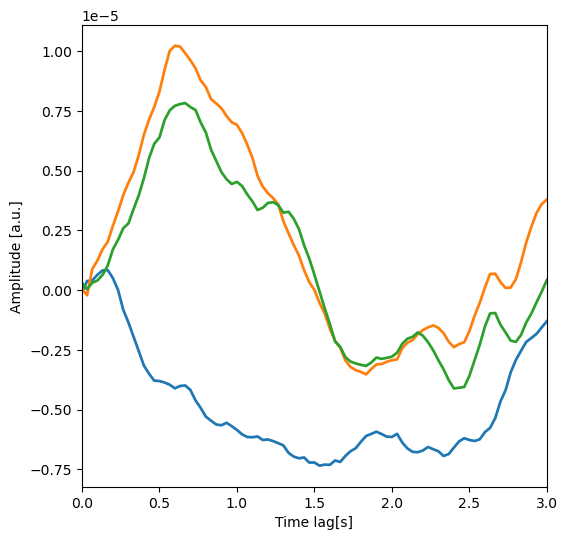

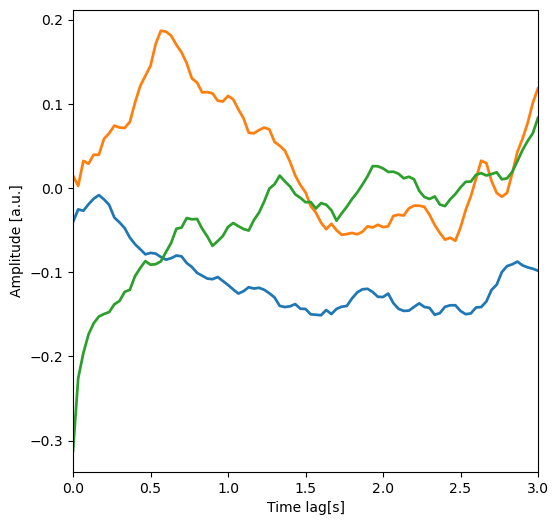

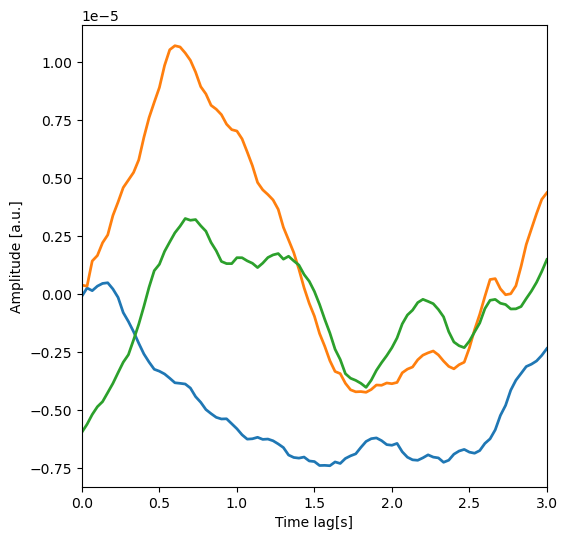

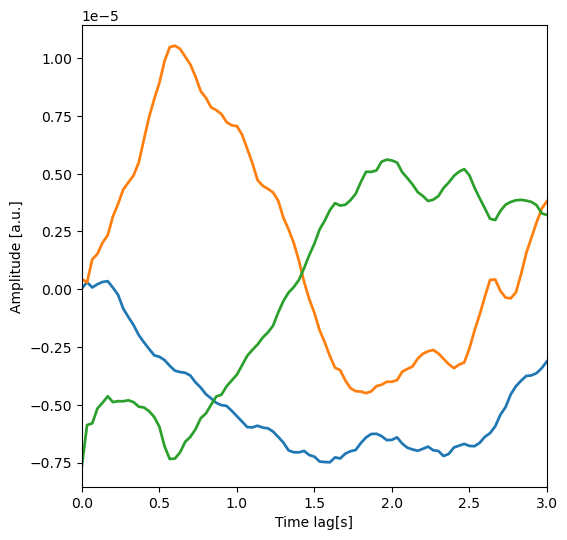

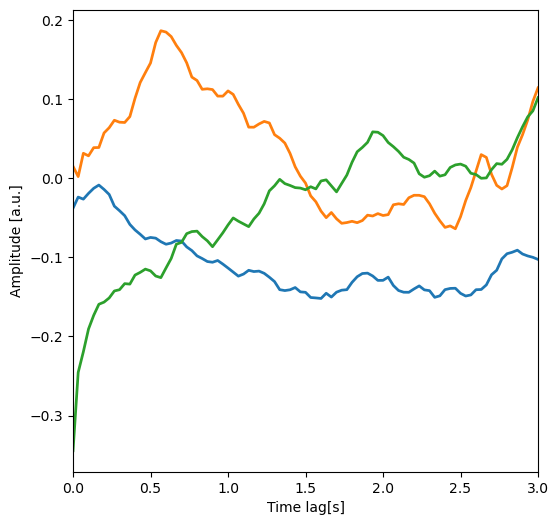

...

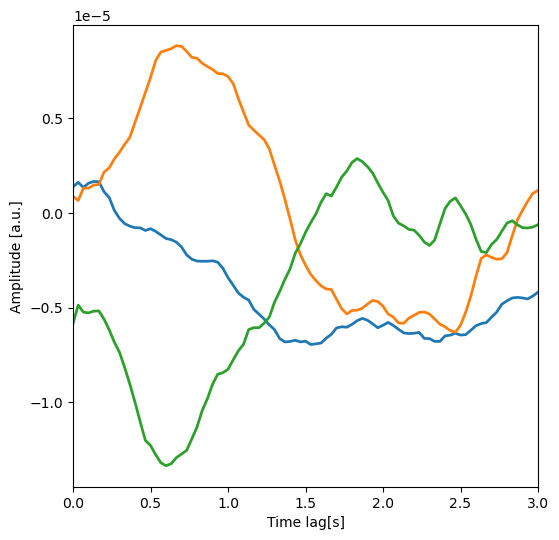

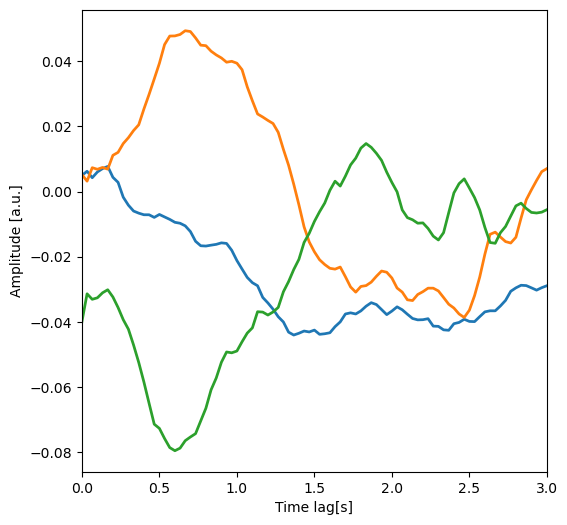

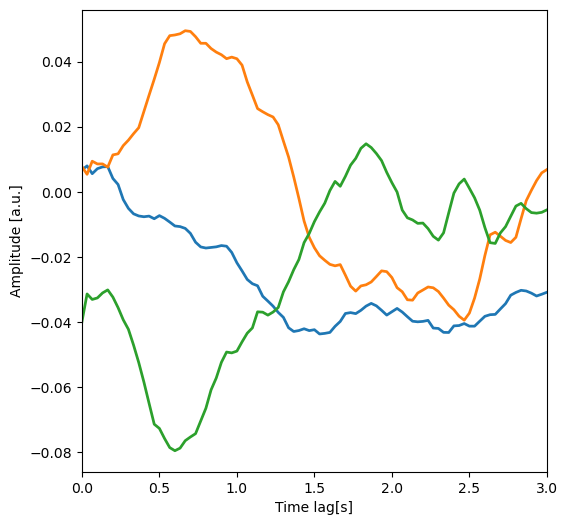

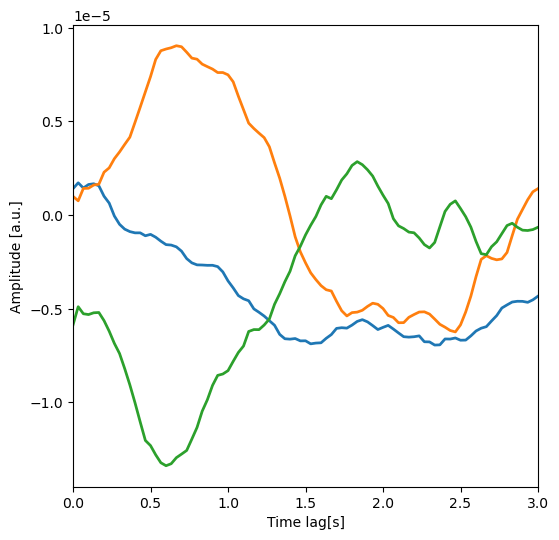

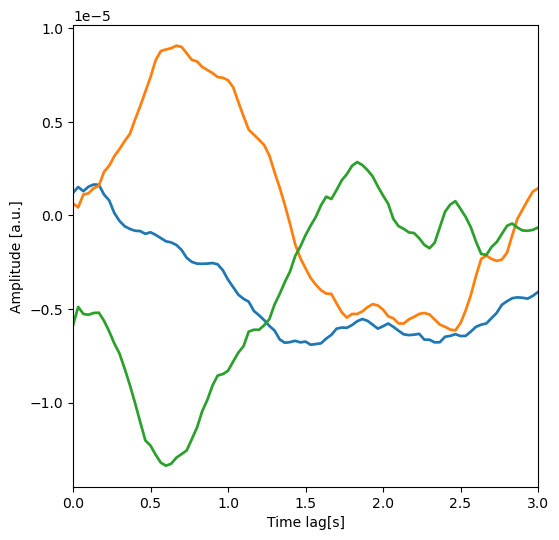

In [60]:
plt.figure(figsize=(15, 10))
plt.subplots_adjust(hspace=1, wspace=0.5)
for i in range(store.get('num_landmarks')):
    trfs[i].plot()

<Axes: xlabel='Condition', ylabel='Pearsonr'>

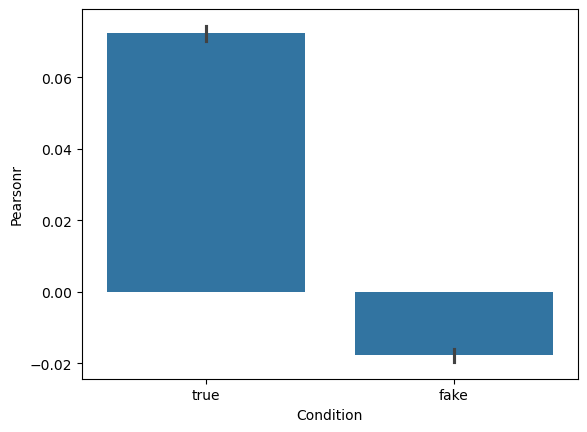

In [62]:
sns.barplot(data=df_post, x='Condition', y='Pearsonr')

In [97]:
df_post.iloc[df_post.Pearsonr.reset_index(drop=True).idxmax()]

Block                                                             va
VideoPath                            ./stim/raw_extracts/8/8_3_F.mov
AudioPath              ./stim/processed_extracts/audio/8/3_audio.wav
SpeakerDyad                                                        8
ListenerDyad                                                       8
SpeakerExtract                                                     3
ListenerExtract                                                    3
Condition                                                       true
SpeakerSex                                                         M
Duration                                                           5
CorrectResp                                                        g
Resp                                                               g
DisplayedDyad                                                      8
Accuracy                                                        True
VideoPathNew                      

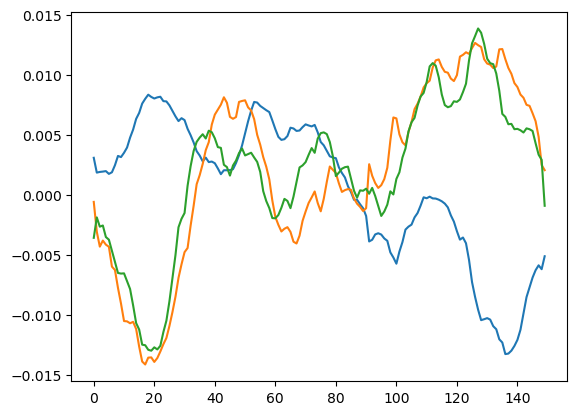

In [96]:
plt.plot(df_post.iloc[df_post.Pearsonr.reset_index(drop=True).idxmax()].Prediction[0])

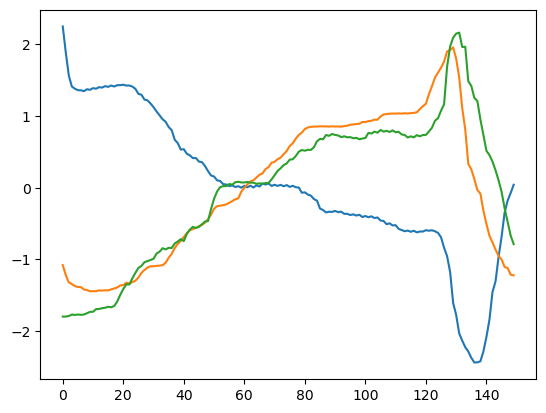

In [98]:
plt.plot(get_data(data_type=store.get('output_type'), file='./landmark_files/8_3_F.csv', length=5, landmark='396'))

In [ ]:
# for row in df:
    # subtract predicted from actual to get 'difference wave'
    # append difference_wave to list

In [ ]:
# create df with (trial, condition, landmark, trf, actual, prediction, correlation, difference_wave)
# columns that might be useful to have: duration, genuineness, sdt_category